<a href="https://colab.research.google.com/github/firman-hoerulloh/Python_GeospatialVisualization/blob/main/Visualisasi_Geospatial_Sebaran_Hasil_Pemilu.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Visualisasi Geospatial Sebaran Hasil Pemilu

## Firman Hoerulloh

## 1301213392


## Link dataset: https://drive.google.com/drive/folders/1OM9MSu7DzkFEoVm2JU3nSHi8mCNvaLxr?usp=sharing

In [ ]:
!pip install pdfplumber geopandas matplotlib

In [ ]:
!pip install geoplot

In [ ]:
import pdfplumber
import pandas as pd
import geopandas as gpd
import geoplot as gplt
import geoplot.crs as gcrs
import matplotlib.pyplot as plt

In [ ]:
# mendownload data rekapitulasi hasil pemilu format pdf dari google drive
!gdown --id 1KizJaW3P9atOD5BrMe9K_ewVaCeOzOt0

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1KizJaW3P9atOD5BrMe9K_ewVaCeOzOt0
To: /content/Rekapitulasi hasil pemilu.pdf
100% 18.9M/18.9M [00:00<00:00, 35.4MB/s]


In [ ]:
# Mengubah file pdf ke csv

# Buka file PDF
pdf_path = 'Rekapitulasi hasil pemilu.pdf'
pdf = pdfplumber.open(pdf_path)

# Ekstraksi data dari halaman tertentu
data = []
columns = None

for page in pdf.pages:
    table = page.extract_table()
    if table:
        if not columns:
            columns = table[0]  # Simpan nama kolom dari baris pertama
        for row in table[1:]:  # Lewati baris pertama
            if len(row) == len(columns):  # Hanya tambahkan baris dengan jumlah kolom yang sesuai
                data.append(row)

# Buat DataFrame dengan kolom yang sesuai
df = pd.DataFrame(data, columns=columns)

# Simpan ke CSV
df.to_csv('/content/pemilu_data.csv', index=False)


In [ ]:
# mendownload data hasil ekstraksi pdf to csv dari google drive
!gdown --id 1QExPH3tkAbJ0P9ZiAPnHuEHoJRvJrvQn

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1QExPH3tkAbJ0P9ZiAPnHuEHoJRvJrvQn
To: /content/pemilu_data.csv
100% 2.27k/2.27k [00:00<00:00, 6.12MB/s]


In [ ]:
#baca data
df = pd.read_csv("pemilu_data.csv")
df.head(10)

,NO,PROVINSI,"H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR",H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA,"H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD",Jumlah
0,1.0,ACEH,2.369.534,787.024,64.677,3.221.235
1,2.0,SUMATERA UTARA,2.339.620,4.660.408,999.528,7.999.556
2,3.0,SUMATERA BARAT,1.744.042,1.217.314,124.044,3.085.400
3,4.0,RIAU,1.400.093,1.931.113,357.298,3.688.504
4,5.0,JAMBI,532.605,1.438.952,234.251,2.205.808
5,6.0,SUMATERA SELATAN,997.299,3.649.651,606.681,5.253.631
6,7.0,BENGKULU,229.681,893.499,145.570,1.268.750
7,8.0,LAMPUNG,791.892,3.554.310,764.486,5.110.688
8,9.0,KEPULAUAN BANGKA BELITUNG,204.348,529.883,151.109,885.340
9,10.0,KEPULAUAN RIAU,370.671,641.388,140.733,1.152.792


In [ ]:
# menghapus kolom 'No'
df.drop(columns=['NO'], inplace=True)
df.head(10)

,PROVINSI,"H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR",H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA,"H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD",Jumlah
0,ACEH,2.369.534,787.024,64.677,3.221.235
1,SUMATERA UTARA,2.339.620,4.660.408,999.528,7.999.556
2,SUMATERA BARAT,1.744.042,1.217.314,124.044,3.085.400
3,RIAU,1.400.093,1.931.113,357.298,3.688.504
4,JAMBI,532.605,1.438.952,234.251,2.205.808
5,SUMATERA SELATAN,997.299,3.649.651,606.681,5.253.631
6,BENGKULU,229.681,893.499,145.570,1.268.750
7,LAMPUNG,791.892,3.554.310,764.486,5.110.688
8,KEPULAUAN BANGKA BELITUNG,204.348,529.883,151.109,885.340
9,KEPULAUAN RIAU,370.671,641.388,140.733,1.152.792


In [ ]:
# Mengunduh file wilayah dari Google Drive
!gdown --id 1V9jbfhtkneEE8C9ca60ufqPoojamukUH

# Mengekstrak file zip
import zipfile

with zipfile.ZipFile("BATAS PROVINSI DESEMBER 2019 DUKCAPIL.zip", 'r') as zip_ref:
    zip_ref.extractall("/content/data")

/usr/local/lib/python3.10/dist-packages/gdown/__main__.py:132: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From (original): https://drive.google.com/uc?id=1V9jbfhtkneEE8C9ca60ufqPoojamukUH
From (redirected): https://drive.google.com/uc?id=1V9jbfhtkneEE8C9ca60ufqPoojamukUH&confirm=t&uuid=dc91c6fe-5ccf-4e5a-9eb0-ff28ecb941ab
To: /content/BATAS PROVINSI DESEMBER 2019 DUKCAPIL.zip
100% 31.1M/31.1M [00:00<00:00, 106MB/s] 


In [ ]:
# Membaca file SHP

wilayah = gpd.read_file("/content/data/BATAS PROVINSI DESEMBER 2019 DUKCAPIL/BATAS_PROVINSI_DESEMBER_2019_DUKCAPIL.shp")
wilayah.head(10)

,OBJECTID,PROVINSI,Shape_Leng,Shape_Area,geometry
0,1,ACEH,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97..."
1,2,BALI,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ..."
2,3,BANTEN,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ..."
3,4,BENGKULU,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ..."
4,5,DAERAH ISTIMEWA YOGYAKARTA,3.342892,0.260130,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ..."
5,6,DKI JAKARTA,3.123689,0.053426,"MULTIPOLYGON Z (((106.87677 -6.10030 0.00003, ..."
6,7,GORONTALO,11.013237,0.977600,"MULTIPOLYGON Z (((121.42536 0.41243 0.00003, 1..."
7,8,JAMBI,11.835072,3.977711,"MULTIPOLYGON Z (((104.40714 -0.86371 0.00003, ..."
8,9,JAWA BARAT,11.614950,3.032785,"MULTIPOLYGON Z (((108.68501 -6.76990 0.00003, ..."
9,10,JAWA TENGAH,15.456349,2.819838,"MULTIPOLYGON Z (((108.88353 -7.74846 0.00003, ..."


In [ ]:
# Gabungkan data geospatial dengan data hasil pemilu
merge_pemilu_wilayah = wilayah.merge(df, left_on='PROVINSI', right_on='PROVINSI')
merge_pemilu_wilayah.head(10)

,OBJECTID,PROVINSI,Shape_Leng,Shape_Area,geometry,"H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR",H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA,"H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD",Jumlah
0,1,ACEH,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97...",2.369.534,787.024,64.677,3.221.235
1,2,BALI,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ...",99.233,1.454.640,1.127.134,2.681.007
2,3,BANTEN,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ...",2.451.383,4.035.052,720.275,7.206.710
3,4,BENGKULU,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ...",229.681,893.499,145.570,1.268.750
4,5,DAERAH ISTIMEWA YOGYAKARTA,3.342892,0.260130,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ...",496.280,1.269.265,741.220,2.506.765
5,6,DKI JAKARTA,3.123689,0.053426,"MULTIPOLYGON Z (((106.87677 -6.10030 0.00003, ...",2.653.762,2.692.011,1.115.138,6.460.911
6,7,GORONTALO,11.013237,0.977600,"MULTIPOLYGON Z (((121.42536 0.41243 0.00003, 1...",227.354,504.662,41.508,773.524
7,8,JAMBI,11.835072,3.977711,"MULTIPOLYGON Z (((104.40714 -0.86371 0.00003, ...",532.605,1.438.952,234.251,2.205.808
8,9,JAWA BARAT,11.614950,3.032785,"MULTIPOLYGON Z (((108.68501 -6.76990 0.00003, ...",9.099.674,16.805.854,2.820.995,28.726.523
9,10,JAWA TENGAH,15.456349,2.819838,"MULTIPOLYGON Z (((108.88353 -7.74846 0.00003, ...",2.866.373,12.096.454,7.827.335,22.790.162


In [ ]:
merge_pemilu_wilayah.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33 entries, 0 to 32
Data columns (total 9 columns):
 #   Column                                                              Non-Null Count  Dtype   
---  ------                                                              --------------  -----   
 0   OBJECTID                                                            33 non-null     int64   
 1   PROVINSI                                                            33 non-null     object  
 2   Shape_Leng                                                          33 non-null     float64 
 3   Shape_Area                                                          33 non-null     float64 
 4   geometry                                                            33 non-null     geometry
 5   H. ANIES RASYID BASWEDAN, Ph.D.
Dr. (H.C.) H. A. MUHAIMIN ISKANDAR  33 non-null     object  
 6   H. PRABOWO SUBIANTO
GIBRAN RAKABUMING RAKA                          33 non-null     object  
 7   H. 

In [ ]:
# Mengubah tipe kolom object menjadi int
merge_pemilu_wilayah['Jumlah'] = merge_pemilu_wilayah['Jumlah'].str.replace('.', '').astype(int)
merge_pemilu_wilayah['H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR'] = merge_pemilu_wilayah['H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR'].str.replace('.', '').astype(int)
merge_pemilu_wilayah['H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA'] = merge_pemilu_wilayah['H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA'].str.replace('.', '').astype(int)
merge_pemilu_wilayah['H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD'] = merge_pemilu_wilayah['H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD'].str.replace('.', '').astype(int)

In [ ]:
# Menampilkan beberapa baris pertama DataFrame
merge_pemilu_wilayah.head()

,OBJECTID,PROVINSI,Shape_Leng,Shape_Area,geometry,"H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR",H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA,"H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD",Jumlah
0,1,ACEH,27.455786,4.625436,"MULTIPOLYGON Z (((97.39178 2.03748 0.00003, 97...",2369534,787024,64677,3221235
1,2,BALI,6.026646,0.458717,"MULTIPOLYGON Z (((115.12509 -8.84761 0.00003, ...",99233,1454640,1127134,2681007
2,3,BANTEN,9.282228,0.764911,"MULTIPOLYGON Z (((105.54977 -6.99566 0.00003, ...",2451383,4035052,720275,7206710
3,4,BENGKULU,11.706367,1.630129,"MULTIPOLYGON Z (((102.38616 -5.47144 0.00003, ...",229681,893499,145570,1268750
4,5,DAERAH ISTIMEWA YOGYAKARTA,3.342892,0.260130,"MULTIPOLYGON Z (((110.81980 -8.20358 0.00003, ...",496280,1269265,741220,2506765


Sebaran Hasil Pemilu

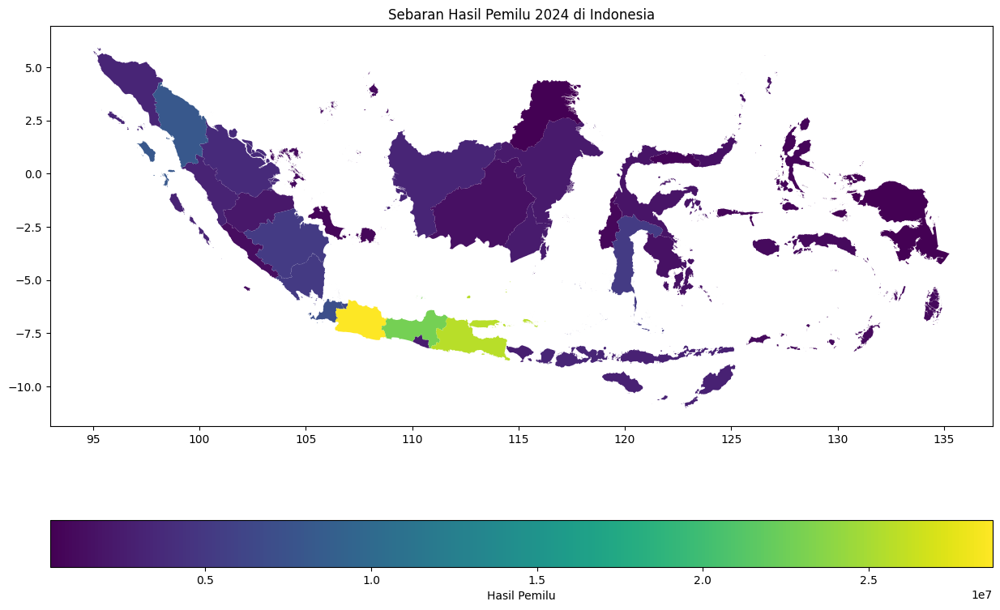

In [ ]:
# Plot sebaran hasil pemilu
fig, ax = plt.subplots(1, 1, figsize=(15, 10))
merge_pemilu_wilayah.plot(column='Jumlah', ax=ax, legend=True,
                           legend_kwds={'label': "Hasil Pemilu", 'orientation': "horizontal"})
plt.title('Sebaran Hasil Pemilu 2024 di Indonesia')
plt.show()


Sebaran Hasil Pemilu Anies & Muhaimin

<ipython-input-189-f7c8bba8b75b>:2: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  merge_pemilu_wilayah_exploded = merge_pemilu_wilayah.explode()


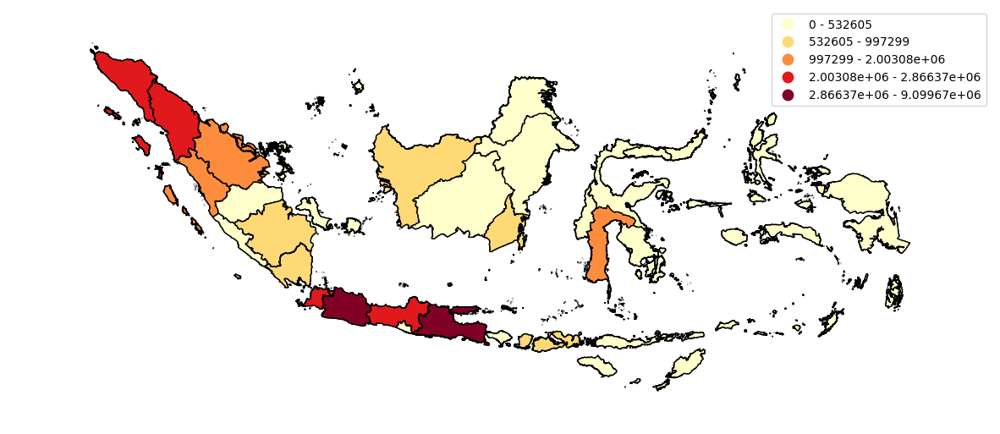

In [ ]:
# Memisahkan MultiPolygon menjadi Polygon tunggal
merge_pemilu_wilayah_exploded = merge_pemilu_wilayah.explode()

# Mengatur ukuran plot
fig, ax = plt.subplots(figsize=(15, 10))

# Membuat plot dasar dengan gplt.polyplot
gplt.polyplot(merge_pemilu_wilayah_exploded, ax=ax)

# Membuat plot choropleth dengan gplt.choropleth
plot1 = gplt.choropleth(merge_pemilu_wilayah_exploded,
                        hue="H. ANIES RASYID BASWEDAN, Ph.D.\nDr. (H.C.) H. A. MUHAIMIN ISKANDAR",
                        cmap="YlOrRd",
                        legend=True,
                        scheme="FisherJenks",
                        ax=ax)

plt.show()


Sebaran Hasil Pemilu Prabowo & Gibran

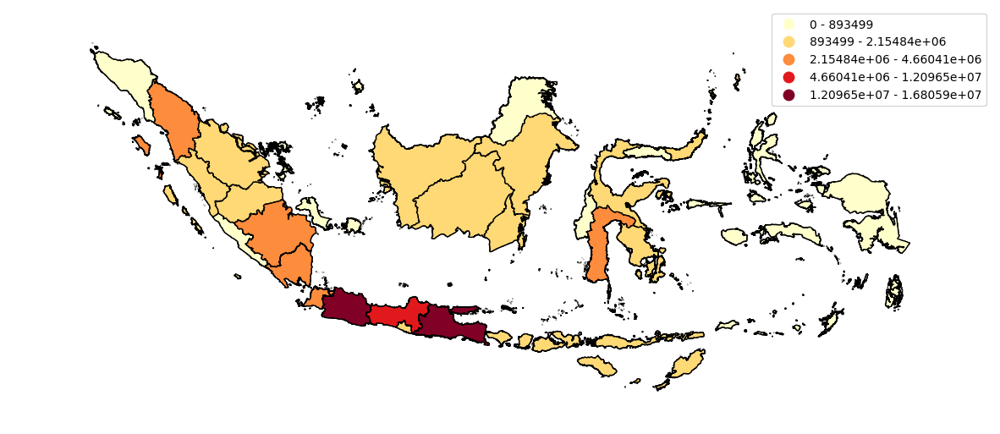

In [ ]:
# # Mengatur ukuran plot
fig, ax = plt.subplots(figsize=(15, 10))

# Membuat plot dasar dengan gplt.polyplot
gplt.polyplot(merge_pemilu_wilayah_exploded, ax=ax)

# Membuat plot choropleth dengan gplt.choropleth
plot2 = gplt.choropleth(merge_pemilu_wilayah_exploded,
                        hue="H. PRABOWO SUBIANTO\nGIBRAN RAKABUMING RAKA",
                        cmap="YlOrRd",
                        legend=True,
                        scheme="FisherJenks",
                        ax=ax)

plt.show()


Sebaran Hasil Pemilu Ganjar & Mahfud

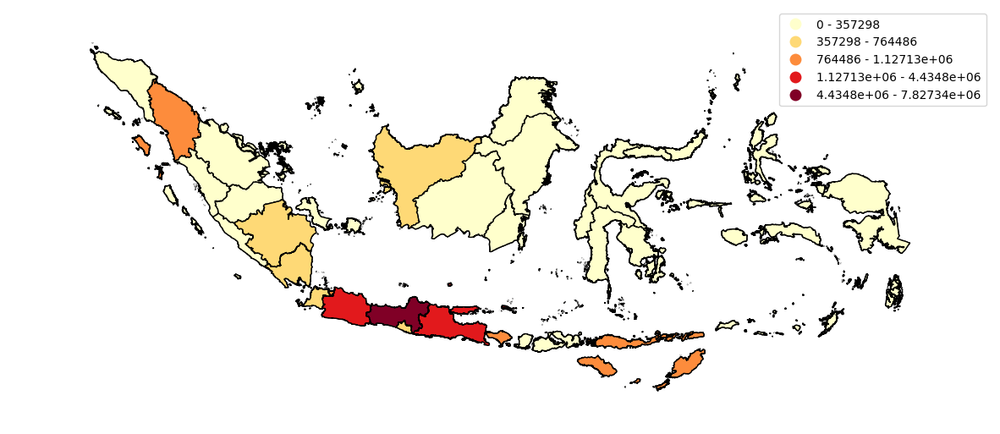

In [ ]:
# Mengatur ukuran plot
fig, ax = plt.subplots(figsize=(15, 10))

# Membuat plot dasar dengan gplt.polyplot
gplt.polyplot(merge_pemilu_wilayah_exploded, ax=ax)

# Membuat plot choropleth dengan gplt.choropleth
plot3 = gplt.choropleth(merge_pemilu_wilayah_exploded,
                        hue="H. GANJAR PRANOWO, S.H., M.I.P.\nProf. Dr. H. M. MAHFUD MD",
                        cmap="YlOrRd",
                        legend=True,
                        scheme="FisherJenks",
                        ax=ax)

plt.show()